In [1]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.graph_objects as go
import numpy as np
df = pd.read_csv('../data/SiouxFalls_net.tntp', sep='\t',skiprows=6)
df

,~,init_node,term_node,capacity,length,free_flow_time,b,power,speed,toll,link_type,;
0,NaN,1,2,25900.200640,6,6,0.15,4,0,0,1,;
1,NaN,1,3,23403.473190,4,4,0.15,4,0,0,1,;
2,NaN,2,1,25900.200640,6,6,0.15,4,0,0,1,;
3,NaN,2,6,4958.180928,5,5,0.15,4,0,0,1,;
4,NaN,3,1,23403.473190,4,4,0.15,4,0,0,1,;
...,...,...,...,...,...,...,...,...,...,...,...,...
71,NaN,23,22,5000.000000,4,4,0.15,4,0,0,1,;
72,NaN,23,24,5078.508436,2,2,0.15,4,0,0,1,;
73,NaN,24,13,5091.256152,4,4,0.15,4,0,0,1,;
74,NaN,24,21,4885.357564,3,3,0.15,4,0,0,1,;


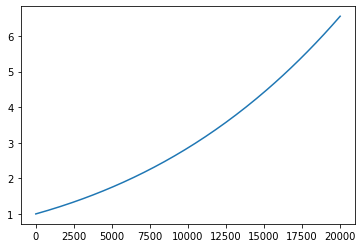

In [2]:
f = np.linspace(0, 20000, 150)
t = 1 * (1 + 0.15*(f/5000))**4
plt.plot(f, t)

In [3]:
links = pd.read_csv('../data/vl_links.txt', sep='\t',skiprows=0)
links_ab = links[['ANODE', 'BNODE', 'cap_ab', 'LENGTH']]
links_ab.columns = ['init_node', 'term_node', 'capacity', 'free_flow_time']
links_ba = links[['ANODE', 'BNODE', 'cap_ba', 'LENGTH']]
links_ba.columns = ['init_node', 'term_node', 'capacity', 'free_flow_time']
links_meruz = links_ab.append(links_ba, ignore_index=True)
links_meruz


,init_node,term_node,capacity,free_flow_time
0,10398,632321,500,19.132429
1,632321,678600,500,19.468851
2,678600,529697,500,12.428828
3,529697,109833,500,5.087750
4,109833,820092,500,37.202867
...,...,...,...,...
176727,807055,807051,500,17.238820
176728,632257,45936,500,29.031130
176729,203723,203722,500,13.817033
176730,203722,203721,500,28.785417


In [4]:
links_meruz[links_meruz.capacity == 0]

,init_node,term_node,capacity,free_flow_time
88398,152522,50303,0,643.316879
88458,6972,625547,0,17.837003
88459,625547,6991,0,53.586044
88460,6991,625024,0,31.484317
88461,625024,625527,0,11.965843
...,...,...,...,...
176508,38428,38429,0,124.697746
176509,38429,542843,0,50.970232
176510,542843,38430,0,24.423223
176638,84793,4002,0,66.351178


In [5]:
links

,LINK,STREET,ANODE,BNODE,LENGTH,type,lanes_ab,speed_ab,cap_ab,lanes_ba,speed_ba,cap_ba,use
0,3050281,NaN,10398,632321,19.132429,OTHER,1,37.290242,500,1,37.290242,500,ANY
1,3050282,NaN,632321,678600,19.468851,OTHER,1,37.290242,500,1,37.290242,500,ANY
2,3050283,NaN,678600,529697,12.428828,OTHER,1,37.290242,500,1,37.290242,500,ANY
3,3050284,NaN,529697,109833,5.087750,OTHER,1,37.290242,500,1,37.290242,500,ANY
4,3050285,NaN,109833,820092,37.202867,OTHER,1,37.290242,500,1,37.290242,500,ANY
...,...,...,...,...,...,...,...,...,...,...,...,...,...
88361,3138642,NaN,807055,807051,17.238820,LOCAL,1,37.290242,500,1,37.290242,500,ANY
88362,3138643,NaN,632257,45936,29.031130,LOCAL,1,37.290242,500,1,37.290242,500,ANY
88363,3138644,NaN,203723,203722,13.817033,LOCAL,1,37.290242,500,1,37.290242,500,ANY
88364,3138645,NaN,203722,203721,28.785417,LOCAL,1,37.290242,500,1,37.290242,500,ANY


In [6]:
px.histogram(links.LENGTH)

In [7]:
df = pd.read_csv('../data/vl_al.txt', sep='\t',skiprows=0)
df

,id,node,link,layer,offset,easting,northing,elevation,tag,notes
0,1217,700866,3106075,AUTO/BUS/WALK,101.497678,731534.477649,4.771207e+06,0.0,Amenity,ferry_terminal
1,1549,5206,3121419,AUTO/BUS/WALK,138.475718,730352.774345,4.770157e+06,0.0,Amenity,ferry_terminal
2,4544,685774,3129815,AUTO/BUS/WALK,35.144522,736211.247059,4.783154e+06,0.0,Amenity,bus_station
3,10111,451620,3072709,AUTO/BUS/WALK,20.998309,733347.999298,4.775567e+06,0.0,Amenity,customs
4,12291,4048,3071122,AUTO/BUS/WALK,17.821082,734245.765042,4.777821e+06,0.0,Amenity,atm
...,...,...,...,...,...,...,...,...,...,...
17098,2992091,199903,3130801,AUTO/BUS/WALK,44.293076,736983.584864,4.782843e+06,0.0,Amenity,parking
17099,2992426,199905,3130802,AUTO/BUS/WALK,72.647152,736960.636134,4.782897e+06,0.0,Amenity,parking
17100,2992515,530841,3105237,AUTO/BUS/WALK,13.426722,736998.091917,4.783060e+06,0.0,Amenity,parking
17101,2992525,531125,3080828,AUTO/BUS/WALK,8.645896,736972.763857,4.783047e+06,0.0,Amenity,parking


In [8]:
px.histogram(links.speed_ab, nbins=20)
#plt.plot(links.cap_ba)

In [9]:
nodes = pd.read_csv('../data/vl_nodes.txt', sep='\t',skiprows=0)
nodes

,node,x,y,z
0,1217,731534.477649,4.771207e+06,0.0
1,1549,730352.774345,4.770157e+06,0.0
2,2768,730999.533019,4.759653e+06,0.0
3,3404,730966.145972,4.759518e+06,0.0
4,3867,736064.309593,4.777656e+06,0.0
...,...,...,...,...
78717,1130922,737093.176526,4.782786e+06,0.0
78718,1131014,737292.141767,4.782721e+06,0.0
78719,1131015,737283.866649,4.782744e+06,0.0
78720,1131022,737236.142703,4.782761e+06,0.0


In [10]:
def coords(id):
    n = nodes[nodes.node == id]
    return n.iloc[:,1:].to_numpy()[0]
def dist(id1, id2):
    return ((coords(id1) - coords(id2))**2).sum()**0.5
dist(152522, 50303)
    

642.1459659588608

In [11]:
mak = links[(links.STREET=='улица Маковского')] #& (links.lanes_ba > 0)]
anodes, bnodes = mak.ANODE.to_numpy(), mak.BNODE.to_numpy()
acoords = np.array([[coords(id)[0], coords(id)[1]] for id in anodes]).T 
bcoords = np.array([[coords(id)[0], coords(id)[1]] for id in bnodes]).T 

x, y = acoords[0], acoords[1] 
#px.scatter(x=acoords[0], y=acoords[1])

fig = go.Figure()

# Add traces
fig.add_trace(go.Scatter(x=x, y=y,
                    mode='markers',
                    name='markers',
                        marker_color='black'))
x, y = bcoords[0], bcoords[1] 
fig.add_trace(go.Scatter(x=x, y=y,
                    mode='markers',
                    name='markers',
                        marker_color='blue'))
fig.add_trace(go.Scatter(x=[coords(86881)[0]], y=[coords(86881)[1]],
                    mode='markers',
                    name='markers',
                        marker_color='magenta'))

In [12]:
mak[mak.ANODE==86881]

,LINK,STREET,ANODE,BNODE,LENGTH,type,lanes_ab,speed_ab,cap_ab,lanes_ba,speed_ba,cap_ba,use
15754,3066035,улица Маковского,86881,86882,229.211654,MAJOR,3,49.720323,500,0,0.0,0,ANY


In [13]:
nodes.x, nodes.y, 

(0        731534.477649
 1        730352.774345
 2        730999.533019
 3        730966.145972
 4        736064.309593
              ...      
 78717    737093.176526
 78718    737292.141767
 78719    737283.866649
 78720    737236.142703
 78721    737170.201740
 Name: x, Length: 78722, dtype: float64,
 0        4.771207e+06
 1        4.770157e+06
 2        4.759653e+06
 3        4.759518e+06
 4        4.777656e+06
              ...     
 78717    4.782786e+06
 78718    4.782721e+06
 78719    4.782744e+06
 78720    4.782761e+06
 78721    4.782720e+06
 Name: y, Length: 78722, dtype: float64)

In [14]:
for row in links:
    print(row)

LINK
STREET
ANODE
BNODE
LENGTH
type
lanes_ab
speed_ab
cap_ab
lanes_ba
speed_ba
cap_ba
use


In [15]:
emp = pd.read_csv('../data/emps.csv', sep='\t')
emp

,Unnamed: 0,Unnamed: 0.1,name,cat,address,emp,vac,lat,lon,district
0,0,0,"Филиал № 1 ООО ""МЕГАКОМ"" В Г.ВЛАДИВОСТОК",Торговля оптовая напитками…,"690039, г Владивосток, ул Русская, д. 46, корп. Б",57,3,43.166235,131.913458,Советский
1,1,1,"Филиал ООО ""Риквэст-Сервис""",Стирка и химическая чистка текстильных и мехов...,"690088, г Владивосток, ш Военное, д. 1, корп. А",93,2,43.132991,131.915460,Первореченский
2,2,2,"""Азиатско-Тихоокеанский Банк"" (ПАО)",Денежное посредничество прочее…,"690091, г Владивосток, ул Светланская, д. 56",209,16,43.113707,131.895645,Ленинский
3,3,3,"""ВЛАДИВОСТОКСКИЙ МОЛОЧНЫЙ КОМБИНАТ"" ФИЛИАЛ АО ...",Производство молока (кроме сырого) и молочной ...,"690087, г Владивосток, ул Стрелочная, д. 19",23,0,43.133784,131.931565,Первореченский
4,4,4,"""ВЛАДИВОСТОКСКИЙ"" ФИЛИАЛ ФГУП ""МОСКОВСКОЕ ПРОП...",Производство медицинских инструментов и оборуд...,"690068, г Владивосток, ул Магнитогорская, д. 8",62,3,43.176999,131.916245,Советский
...,...,...,...,...,...,...,...,...,...,...
1321,1321,1321,ЧОУ ВМСОШ,Образование дошкольное…,"690041, г Владивосток, ул Горького, д. 10",42,2,43.206485,131.946023,Советский
1322,1322,1322,"ЧОУ ДОД ""ЦЕНТР СПОРТИВНОЙ ПОДГОТОВКИ ""ОЛИМПИЕЦ""",Образование дополнительное детей и взрослых…,"690025, г Владивосток, ул Таежная, д. 8",37,0,43.247029,132.043803,Советский
1323,1323,1323,"Чугуевский филиал КГКУ ""Приморское лесничество""",Лесоводство и прочая лесохозяйственная деятель...,"692623, р-н Чугуевский, с Чугуевка, ул Лесная,...",43,4,44.159503,133.881478,NaN
1324,1324,1324,"ЧУЗ ""КБ ""РЖД-МЕДИЦИНА"" Г. ВЛАДИВОСТОК",Деятельность больничных организаций,"690003, г Владивосток, ул Верхнепортовая, д. 25",475,6,43.104096,131.871359,Фрунзенский


In [16]:
R = 6371 * 1000
ax = R * np.pi / 180 * np.cos((emp.lat * np.pi / 180).mean()) 
emp['x'] = emp.lon * ax
ay = R * np.pi / 180
emp['y'] = emp.lat * ay
emp.x = emp.x  -570e6
emp.y = emp.y - 270e6
emp['size'] = emp.emp.apply(lambda x: x**0.5)

In [17]:
ans = links.set_index('ANODE').join(nodes.set_index('node'))[['type', 'x', 'y']]
ans['size'] = ((ans['type'] == 'MAJOR') * 5 + (ans['type'] == 'MINOR') * 3 + 1)/5
ans['color'] = -2 #ans['size']
ans.x -= 4 # to distinguish a and b til implement directed edges 
#ans.y -= 1
ans['sym'] = ['triangle-up']*ans.shape[0]


# fig = px.scatter(ans, x='x', y='y', color='color', size='size', text=ans.index)
bns = links.set_index('BNODE').join(nodes.set_index('node'))[['type', 'x', 'y']]
bns['size'] = ((bns['type'] == 'MAJOR') * 5 + (bns['type'] == 'MINOR') * 3 + 1)/5
bns['color'] = -3 #-bns['size']
bns['sym'] = ['triangle-down']*bns.shape[0]
bns.x += 4
#bns.y += 1
# nsize.x = nsize.x / 1e6
# nsize.y = nsize.y / 1e6
ns = ans.append(bns, ignore_index=True)




    
nds = nodes.set_index('node')
x, y, node = [], [], []
for i in range(links.shape[0]):
    an, bn = links.ANODE[i], links.BNODE[i]
    x += [nds.x[an], nds.x[bn], None]
    y += [nds.y[an], nds.y[bn], None]
    node += [an, bn, None]
edges = pd.DataFrame({'x':x, 'y':y, 'node':node})


In [18]:
x0 = np.array([736130.6, 4761298])
y0 = np.array([42.967722, 131.895320])[::-1]
x1 = np.array([763430, 4807718])
y1 = np.array([43.375730, 132.251674])[::-1]
a = (y1 - y0) / (x1 - x0)
# b = y0 - a * x0
# emp['x'] = emp.lat * a[0] - R[0]
# emp['y'] = emp.lon * a[1] - R[1]
R = x0 * a - y0

def to_lon(x):
    return x * a[0] - R[0]

def to_lat(y):
    return y * a[1] - R[1] 
    
edges['lon'] = to_lon(edges.x)
edges['lat'] = to_lat(edges.y)
ns['lon'] = to_lon(ns.x)
ns['lat'] = to_lat(ns.y)
a, ax, ay, R

(array([1.30535470e-05, 8.78948729e-06]),
 81026.37801170826,
 111194.92664455873,
 array([-122.28620464,   -1.11835375]))

In [19]:
# d_inv = dict(enumerate(emp.district.unique()))
d_inv = {
    0: 'Советский',
    1: 'Первореченский',
    2: 'Ленинский',
    3: np.NaN,
    4: 'Фрунзенский',
    5: 'Первомайский'
}
d = {v: k for k, v in d_inv.items()}
d_inv

{0: 'Советский',
 1: 'Первореченский',
 2: 'Ленинский',
 3: nan,
 4: 'Фрунзенский',
 5: 'Первомайский'}

In [20]:


emp['coord'] = emp.lat.apply(str) + " " + emp.lon.apply(str)
emp['dis'] = emp.district.apply(lambda x : d[x])
px.scatter(emp[emp.dis != d[np.NaN]], x='x', y='y', size='emp', color='dis')#, symbol='sym')#, 

In [21]:


emp['coord'] = emp.lat.apply(str) + " " + emp.lon.apply(str)
emp['dis'] = emp.district.apply(lambda x : d[x])
emp_vl = emp[emp.dis != d[np.NaN]]
emp_f = emp[(emp.lon > 131.5) & (emp.lon < 132.5) & (emp.lat > 42.9) & (emp.lat < 43.5)]
# emp_f = emp_f[emp_f['dis'] == 1]

px.scatter(emp_vl, x='lon', y='lat', size='emp', color='dis')#, symbol='sym')#, 

In [22]:
trips_nodes_dict = {
        'Первомайский' : [98866, 7207, 113059, 95578, 40490],
        'Ленинский' : [642953, 33705, 512055, 98893, 500285],
        'Фрунзенский' : [7870, 453482, 4049, 4257, 4306],
        'Первореченский' : [43005, 608219, 567092, 11011, 79983],
        'Советский' : [5949, 12012, 678253, 746461, 768114]
    }

dis = []
x , y = [], []
for key, val in trips_nodes_dict.items():
    dis += [d[key]] * len(val)
    for n in val:
        x.append(nds.x[n])
        y.append(nds.y[n])
trips_nodes = pd.DataFrame({'x':x, 'y':y, 'dis':dis})
trips_nodes['lat'] = to_lat(trips_nodes.y)
trips_nodes['lon'] = to_lon(trips_nodes.x)

In [33]:
traces = []
fig = px.scatter(ns, x='lon', y='lat', color='color', size='size', opacity=0.3)#, symbol='sym')#, text=nsize.index)
# traces += [go.Scatter(
#     x=ns.lon,
#     y=ns.lat,
#     mode='markers',
#     marker=dict(size=ns.size, color=ns.color)
#     )]
traces.append(
    go.Scatter(
        x=emp_f.lon,
        y=emp_f.lat,
        mode='markers',
        marker=dict(size=np.log(emp_f.emp.values + 1)*5,
                color=emp_f.dis, opacity = 0.7)
    )
)
traces.append(
    go.Scattergl(
            x=edges.lon,
            y=edges.lat,
            line=dict(color='green')
    )
)
traces.append(
    go.Scatter(
        x=trips_nodes.lon,
        y=trips_nodes.lat,
        mode='markers',
        marker_symbol='square',
        marker=dict(size=20,
                    line=dict(width=5,color='black'),
                color=trips_nodes.dis)#, opacity = 0.8)
    )
)

fig = go.Figure(data=traces)

fig.update_layout(
    autosize=False,
    width=1000,
    height=1000)

fig.update_yaxes(
    scaleanchor = "x",
    scaleratio = a[0]/a[1],
  )
fig.update_traces(opacity=0.3, selector=dict(type='scattergl'))
fig.update_traces(text=edges.node, selector=dict(type='scattergl'))
fig.show()

In [25]:
d

{'Советский': 0,
 'Первореченский': 1,
 'Ленинский': 2,
 nan: 3,
 'Фрунзенский': 4,
 'Первомайский': 5}

In [26]:
for district in set(emp.district.values):
    print(f'{district}:\t {emp[emp.district.apply(lambda x: x == district)].emp.sum()}') 

nan:	 0
Первореченский:	 29968
Советский:	 85703
Первомайский:	 21446
Фрунзенский:	 59048
Ленинский:	 58635


In [27]:
dis_works = {}
for district in set(emp.district.values):
    works = emp[emp.district.apply(lambda x: x == district)].emp.sum()
    # emp.district == None doesnt work    
#     print(f'{district}:\t {works}')
    dis_works[district] = works
dis_works

{nan: 0,
 'Первореченский': 29968,
 'Советский': 85703,
 'Первомайский': 21446,
 'Фрунзенский': 59048,
 'Ленинский': 58635}

In [28]:
dis_residents = {
    "Ленинский": 153_882,
    "Первомайский": 155_072,
    "Первореченский": 145_067,
    "Советский": 92_140,
    "Фрунзенский": 58_740
}

dis_residents_scaled = {}
for key, value in dis_residents.items():
    dis_residents_scaled[key] = int(value / sum(dis_residents.values()) * sum(dis_works.values()))
dis_residents_scaled["Ленинский"] += sum(dis_works.values()) - sum(dis_residents_scaled.values()) 
sum(dis_works.values()), sum(dis_residents_scaled.values())

(254800, 254800)

In [29]:
trip_nodes, L, W = [], [], []
for district, nodes in trips_nodes_dict.items():
    trip_nodes += nodes
    split = len(nodes)
    
    res = dis_residents_scaled[district]  
    l = [int(res / split)] * split
    l[-1] += res - sum(l)
    L += l
    
    work = dis_works[district]  
    w = [int(work / split)] * split 
    w[-1] += work - sum(w)
    W += w
    
print (trip_nodes, L, W, sep='\n')
with open('../data/vl_trips.txt', 'w') as f:
    f.write('trip nodes, L, W\n')
    f.write(' '.join([str(n) for n in trip_nodes]) + '\n')
    f.write(' '.join([str(n) for n in L]) + '\n')
    f.write(' '.join([str(n) for n in W]) + '\n')
    
# for district, target_nodes in trips_nodes_dict.items():
#     target_split = len(target_nodes)
        
    
sum(L), sum(W)
    

[98866, 7207, 113059, 95578, 40490, 642953, 33705, 512055, 98893, 500285, 7870, 453482, 4049, 4257, 4306, 43005, 608219, 567092, 11011, 79983, 5949, 12012, 678253, 746461, 768114]
[13064, 13064, 13064, 13064, 13064, 12964, 12964, 12964, 12964, 12966, 4948, 4948, 4948, 4948, 4950, 12221, 12221, 12221, 12221, 12221, 7762, 7762, 7762, 7762, 7763]
[4289, 4289, 4289, 4289, 4290, 11727, 11727, 11727, 11727, 11727, 11809, 11809, 11809, 11809, 11812, 5993, 5993, 5993, 5993, 5996, 17140, 17140, 17140, 17140, 17143]


(254800, 254800)

In [30]:
x = links.cap_ab.values
np.where(x == np.max(x))

(array([    0,     1,     2, ..., 88363, 88364, 88365]),)

In [31]:
from scipy.sparse import dok_matrix
d = dok_matrix((5,5))
d[1] = [0, 0, 1, 2, 3]
np.array(d.sum(axis=1))

array([[0.],
       [6.],
       [0.],
       [0.],
       [0.]])

In [32]:
from collections import defaultdict
gg = defaultdict() 
gg['sfdsdf']

KeyError: 'sfdsdf'